# Price Data

Information about the columns:

| Field | Description | Notes | 
| --- | --- | --- | 
| DateValueCET | Day  | yyyy-mm-dd  | 
| TimeValueCET | Hour | hh:mm:ss | 
| PowerPriceAreaCode | Different geographic and hydrological regions in Brazil | Values: BRAZIL_SOUTH, BRAZIL_NORTH, BRAZIL_NORTHEAST, RAZIL_SOUTHEAST_CENTRALWEST |
| PriceMWh | Settlement Price - the trading price that is invoiced for the specific time period | Unit: BRL per MW/h (Brazilian Real per Mega Watt/ hour) |

In [2]:
import pandas as pd 

# Read Price Data Excel file
df_price = pd.read_excel('./data_sources/Price Data.xlsx')
df_price.columns                        

Index(['DataProvider', 'DataSource', 'DateValueCET', 'TimeValueCET',
       'TimeValueOffsetCET', 'TimeValueUTCOffset', 'PowerPriceArea',
       'PowerPriceAreaCode', 'Granularity', 'GranularityCode', 'Actuality',
       'ActualityCode', 'AuctionSequence', 'AuctionSequenceCode',
       'PriceSpecification', 'PriceSpecificationNameCode', 'Currency',
       'Exchange', 'AllegroPriceindex', 'ValueDateTimeOffset', 'PriceMWh',
       'ReportDateTimeOffset', 'RowInsertedInARIS', 'RowUpdatedInARIS'],
      dtype='object')

In [3]:
df_price = df_price[['DateValueCET', 'TimeValueCET', 'PowerPriceAreaCode', 'PriceMWh']]
display(df_price.head())

,DateValueCET,TimeValueCET,PowerPriceAreaCode,PriceMWh
0,2024-09-12,04:00:00,BRAZIL_NORTH,286.29
1,2024-09-12,04:00:00,BRAZIL_NORTHEAST,286.24
2,2024-09-12,04:00:00,BRAZIL_SOUTH,286.28
3,2024-09-12,04:00:00,BRAZIL_SOUTHEAST_CENTRALWEST,286.28
4,2024-09-12,03:00:00,BRAZIL_NORTH,304.05


In [4]:
df_price['DateValueCET'] = pd.to_datetime(df_price['DateValueCET'])
df_price['TimeValueCET'] = pd.to_timedelta(df_price['TimeValueCET'])
df_price['DateTime'] = df_price['DateValueCET'] + df_price['TimeValueCET']
display(df_price.head())


,DateValueCET,TimeValueCET,PowerPriceAreaCode,PriceMWh,DateTime
0,2024-09-12,0 days 04:00:00,BRAZIL_NORTH,286.29,2024-09-12 04:00:00
1,2024-09-12,0 days 04:00:00,BRAZIL_NORTHEAST,286.24,2024-09-12 04:00:00
2,2024-09-12,0 days 04:00:00,BRAZIL_SOUTH,286.28,2024-09-12 04:00:00
3,2024-09-12,0 days 04:00:00,BRAZIL_SOUTHEAST_CENTRALWEST,286.28,2024-09-12 04:00:00
4,2024-09-12,0 days 03:00:00,BRAZIL_NORTH,304.05,2024-09-12 03:00:00


In [16]:
df_price['DateTime'] = pd.to_datetime(df_price['DateTime'])

In [33]:
# Extract the day of the year (1-365 or 366) and the hour of the day
df_price['day_of_year'] = df_price['DateTime'].dt.dayofyear
df_price['hour'] = df_price['DateTime'].dt.hour
df_price['year'] = df_price['DateTime'].dt.year


In [32]:
df_price_2024 = df_price[df_price['DateTime'].dt.year == 2024]
df_price_2023 = df_price[df_price['DateTime'].dt.year == 2023]

In [30]:

df_price_2022 = df_price[df_price['DateTime'].dt.year == 2022]


In [39]:
import plotly.express as px

fig = px.scatter(
    df_price, 
    x='hour', 
    y='PriceMWh',  # Use your actual energy load column here
    color='year',  # # Color by year to differentiate the years 
    facet_col='PowerPriceAreaCode',  # Create a subplot for each region (PowerPriceAreaCode)
    animation_frame='day_of_year',  # This allows us to animate the graph by each hour of the day
    title="Price by Day of Year and Hour",
    labels={'day_of_year': 'Day of the Year', 'PriceMWh': 'Price (MW)'},
    hover_data=['DateTime', 'hour'],  # Add extra info to hover
    width=1500,  # Custom width
    height=800
)

# Show the plot
fig.show()

In [25]:
import plotly.express as px

fig = px.scatter(
    df_price_2022, 
    x='hour', 
    y='PriceMWh',  # Use your actual energy load column here
    color='PowerPriceAreaCode',  # Differentiate regions
    animation_frame='day_of_year',  # This allows us to animate the graph by each hour of the day
    title="2022 Price by Day of Year and Hour",
    labels={'day_of_year': 'Day of the Year', 'PriceMWh': 'Price (MW)'},
    hover_data=['DateTime', 'hour'],  # Add extra info to hover
    width=1200,  # Custom width
    height=800
)

# Show the plot
fig.show()

In [26]:
import plotly.express as px

fig = px.scatter(
    df_price_2023, 
    x='hour', 
    y='PriceMWh',  
    color='PowerPriceAreaCode',  # Differentiate regions
    animation_frame='day_of_year',  
    title="2023 Price by Day of Year and Hour",
    labels={'day_of_year': 'Day of the Year', 'PriceMWh': 'Price (MW)'},
    hover_data=['DateTime', 'hour'],  # Add extra info to hover
    width=1200,  # Custom width
    height=800
)

# Show the plot
fig.show()

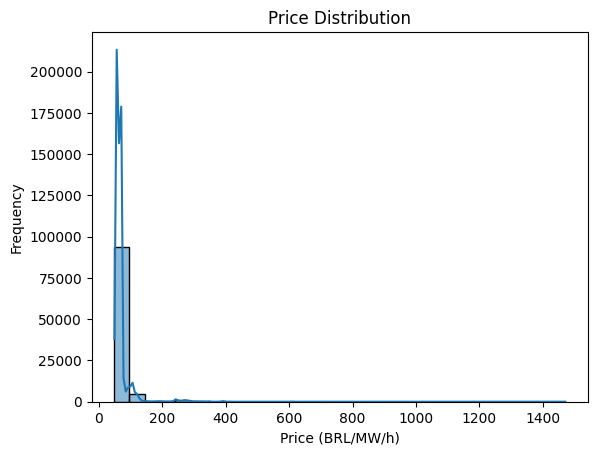

In [5]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.histplot(df_price['PriceMWh'], bins=30, kde=True)
plt.title('Price Distribution')
plt.xlabel('Price (BRL/MW/h)')
plt.ylabel('Frequency')
plt.show()


In [51]:
import plotly.express as px

# Price overview by regions throughout the years
plot = px.line( 
    df_price,
    x='DateTime',
    y='PriceMWh',
    color='PowerPriceAreaCode',
    title='Electricity Prices Over Time by Region',
    labels={'PriceMWh': 'Price (MWh)', 'DateTime': 'Date and Time'}
)

plot.show()


In [52]:
# Filter for a specific year

year_filter = 2024
df_price_2024 = df_price[df_price['DateTime'].dt.year == year_filter]

plot2 = px.line( 
    df_price_2024,
    x='DateTime',
    y='PriceMWh',
    color='PowerPriceAreaCode',
    title='Electricity Prices in by Region',
    labels={'PriceMWh': 'Price (MWh)', 'DateTime': 'Date and Time'}
)

plot2.show()

In [53]:
# Filter for a specific year

year_filter = 2023
df_price_2023 = df_price[df_price['DateTime'].dt.year == year_filter]

plot2 = px.line( 
    df_price_2023,
    x='DateTime',
    y='PriceMWh',
    color='PowerPriceAreaCode',
    title='Electricity Prices Over Time by Region',
    labels={'PriceMWh': 'Price (MWh)', 'DateTime': 'Date and Time'}
)

plot2.show()

In [54]:
# Filter for a specific year

year_filter = 2022
df_price_2022 = df_price[df_price['DateTime'].dt.year == year_filter]

plot2 = px.line( 
    df_price_2022,
    x='DateTime',
    y='PriceMWh',
    color='PowerPriceAreaCode',
    title='Electricity Prices Over Time by Region',
    labels={'PriceMWh': 'Price (MWh)', 'DateTime': 'Date and Time'}
)

plot2.show()

In [55]:
# Group by region and hour, and calculate the mean price per hour for each region
df_grouped = df_price_2024.groupby(['PowerPriceAreaCode', 'Hour']).agg({
    'PriceMWh': 'mean'  
}).reset_index()


fig = px.line(df_grouped, x='Hour', y='PriceMWh', color='PowerPriceAreaCode',
              labels={
                  'Hour': 'Hour of the Day',
                  'PriceMWh': 'Average Price (PriceMWh)',
                  'PowerPriceAreaCode': 'Region'
              },
              title=f'Average Power Price Over 24 Hours for 2024 by Region')


fig.update_layout(
    xaxis=dict(tickmode='linear', tick0=0, dtick=1),  # Set x-axis ticks to display all 24 hours
    hovermode='x unified', 
    width=900,
    height=600
)


fig.show()


In [56]:
df_grouped = df_price_2023.groupby(['PowerPriceAreaCode', 'Hour']).agg({
    'PriceMWh': 'mean'  
}).reset_index()


fig = px.line(df_grouped, x='Hour', y='PriceMWh', color='PowerPriceAreaCode',
              labels={
                  'Hour': 'Hour of the Day',
                  'PriceMWh': 'Average Price (PriceMWh)',
                  'PowerPriceAreaCode': 'Region'
              },
              title=f'Average Power Price Over 24 Hours for 2023 by Region')


fig.update_layout(
    xaxis=dict(tickmode='linear', tick0=0, dtick=1),  
    hovermode='x unified', 
    width=900,
    height=600
)


fig.show()


In [57]:
df_grouped = df_price_2022.groupby(['PowerPriceAreaCode', 'Hour']).agg({
    'PriceMWh': 'mean'  
}).reset_index()


fig = px.line(df_grouped, x='Hour', y='PriceMWh', color='PowerPriceAreaCode',
              labels={
                  'Hour': 'Hour of the Day',
                  'PriceMWh': 'Average Price (PriceMWh)',
                  'PowerPriceAreaCode': 'Region'
              },
              title=f'Average Power Price Over 24 Hours for 2022 by Region')


fig.update_layout(
    xaxis=dict(tickmode='linear', tick0=0, dtick=1),  
    hovermode='x unified', 
    width=900,
    height=600
)


fig.show()